# Openclassrooms PJ7 part 2 : implement automatic image indexing

In [1]:
## Specific installs / import in online notebook

In [2]:
!pip install opencv-python==3.4.2.17

     |████████████████████████████████| 25.0 MB 20.7 MB/s 
  Attempting uninstall: opencv-python
    Found existing installation: opencv-python 4.4.0.42
    Uninstalling opencv-python-4.4.0.42:
      Successfully uninstalled opencv-python-4.4.0.42
ERROR: After October 2020 you may experience errors when installing or updating packages. This is because pip will change the way that it resolves dependency conflicts.

We recommend you use --use-feature=2020-resolver to test your packages with the new resolver before it becomes the default.

albumentations 0.4.6 requires opencv-python>=4.1.1, but you'll have opencv-python 3.4.2.17 which is incompatible.
You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.


In [3]:
!pip install opencv-contrib-python==3.4.2.17

     |████████████████████████████████| 30.6 MB 17.6 MB/s 
You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.


In [4]:
%matplotlib inline

#%load_ext autoreload  # Autoreload has a bug : when you modify function in source code and run again, python kernel hangs :(
#%autoreload 2

import datetime as dt

import sys, importlib

from functions_py import * # MODIFIED for kaggle (replaced by functions_py instead of functions)
importlib.reload(sys.modules['functions_py']) # MODIFIED for kaggle

from display_factorial import *
importlib.reload(sys.modules['display_factorial'])

import pandas as pd

pd.set_option('display.max_rows', 200)
pd.set_option('display.max_columns', 200)

import datetime as dt

import os
import zipfile
import urllib

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np   
  
import plotly as py
import plotly.graph_objects as go
import ipywidgets as widgets

import qgrid

import glob

from pandas.plotting import scatter_matrix

from sklearn.model_selection import StratifiedShuffleSplit

from sklearn.model_selection import GridSearchCV

from sklearn.manifold import TSNE
from sklearn.manifold import LocallyLinearEmbedding
from sklearn.manifold import Isomap

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.metrics import pairwise_distances
from sklearn.cluster import AgglomerativeClustering
from scipy.stats import entropy

from sklearn.feature_selection import RFE

from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.multioutput import MultiOutputClassifier
from sklearn.linear_model import Perceptron
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score

from sklearn.metrics import classification_report

from sklearn.metrics import confusion_matrix

#from yellowbrick.classifier import ROCAUC
from sklearn.metrics import roc_auc_score

import nltk
import codecs

from sklearn.decomposition import LatentDirichletAllocation

#from nltk.corpus.reader.api import CorpusReader
#from nltk.corpus.reader.api import CategorizedCorpusReader

from nltk import pos_tag, sent_tokenize, wordpunct_tokenize

#import pandas_profiling

from bs4 import BeautifulSoup

DATA_PATH = os.path.join("../input", "stanford-dogs-dataset", "images") # Modified for kaggle
DATA_PATH = os.path.join(DATA_PATH, "Images")

#DATA_PATH_FILE_INPUT = os.path.join(DATA_PATH, "QueryResults_20190101-20200620.csv")
#DATA_PATH_FILE_INPUT = os.path.join(DATA_PATH, "QueryResults 20200301-20200620_1.csv")

DATA_PATH_FILE = os.path.join(DATA_PATH, "*.csv")
ALL_FILES_LIST = glob.glob(DATA_PATH_FILE)

ALL_FEATURES = []

plt.rcParams["figure.figsize"] = [16,9] # Taille par défaut des figures de matplotlib

import seaborn as sns
from seaborn import boxplot
sns.set()

#import common_functions

####### Paramètres pour sauver et restaurer les modèles :
import pickle
####### Paramètres à changer par l'utilisateur selon son besoin :

'''
RECOMPUTE_GRIDSEARCH = True  # CAUTION : computation is several hours long
SAVE_GRID_RESULTS = False # If True : grid results object will be saved to pickle files that have GRIDSEARCH_FILE_PREFIX
LOAD_GRID_RESULTS = False # If True : grid results object will be loaded from pickle files that have GRIDSEARCH_FILE_PREFIX
                          # Grid search results are loaded with full samples (SAMPLED_DATA must be False)
'''


RECOMPUTE_GRIDSEARCH = False  # CAUTION : computation is several hours long
SAVE_GRID_RESULTS = False # If True : grid results object will be saved to pickle files that have GRIDSEARCH_FILE_PREFIX
LOAD_GRID_RESULTS = True # If True : grid results object will be loaded from pickle files that have GRIDSEARCH_FILE_PREFIX

#GRIDSEARCH_CSV_FILE = 'grid_search_results.csv'

GRIDSEARCH_FILE_PREFIX = 'grid_search_results_'

# Set this to load (or train again / save) Clustering model to disk
SAVE_CLUSTERING_MODEL = True
CLUSTERING_FILE_MODEL_PREFIX = 'clustering_model'

SAVE_DESCRIPTORS = True
DESCRIPTORS_FILE_PREFIX = 'descriptors_file'


SAVE_BESTGRIDSEARCH_MODEL = False
LOAD_BESTGRIDSEARCH_MODEL = True
BESTGRIDSEARCH_FILE_MODEL_PREFIX = 'bestgridsearch_model_'

EXECUTE_INTERMEDIATE_MODELS = True # If True: every intermediate model (which results are manually analyzed in the notebook) will be executed


# Necessary for predictors used in the notebook :
from sklearn.linear_model import LinearRegression
from sklearn.compose import TransformedTargetRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error

from sklearn.preprocessing import PolynomialFeatures

### For progress bar :
#from tqdm import tqdm_notebook as tqdm  #Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
from tqdm.notebook import tqdm

# Statsmodel : 
import statsmodels.formula.api as smf

import statsmodels.api as sm
from scipy import stats

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

from nltk.cluster import KMeansClusterer # NLTK algorithm will be useful for cosine distance

SAVE_API_MODEL = True # If True : API model ill be saved
API_MODEL_PICKLE_FILE = 'API_model_PJ7.pickle'


LEARNING_CURVE_STEP_SIZE = 100

from sklearn.model_selection import train_test_split
from sklearn.metrics import make_scorer

In [5]:
from PIL import Image
from io import BytesIO

In [6]:
# Those variables must be consisten with what first notebook has been ran with
NB_CLASSES = 20

NB_DOGS_PER_RACE = 100 # 100. Note: we have 120 dog races in the dataset
NB_KEYPOINTS_PER_DOG = 200 # 200
NB_CLUSTERS = 1000

In [7]:
!ls -l ../input/openclassrooms-pj7-modelisation/

total 60352
-rw-r--r-- 1 nobody nogroup  2853391 Sep  6 15:03 __notebook__.ipynb
-rw-r--r-- 1 nobody nogroup   611261 Sep  6 15:03 __output__.json
-rw-r--r-- 1 nobody nogroup   442658 Sep  6 15:03 __results__.html
drwxr-xr-x 2 nobody nogroup     4096 Sep  6 15:03 __results___files
-rw-r--r-- 1 nobody nogroup  2614403 Sep  6 15:03 clustering_modelmodel1.pickle
-rw-r--r-- 1 nobody nogroup        0 Sep  6 15:03 custom.css
-rw-r--r-- 1 nobody nogroup 54847324 Sep  6 15:03 descriptors_filemodel1.pickle
-rw-r--r-- 1 nobody nogroup   179408 Sep  6 15:03 filenamesmodel1.pickle
-rw-r--r-- 1 nobody nogroup   127047 Sep  6 15:03 sift_keypoints.jpg
-rw-r--r-- 1 nobody nogroup    98368 Sep  6 15:03 sift_keypoints_best.jpg


In [8]:
!date

Tue Sep  8 22:20:18 UTC 2020


# Load sift descriptors and their clusters, and picture labels

In [9]:
with open('../input/openclassrooms-pj7-modelisation/clustering_modelmodel1.pickle', 'rb') as f:
    clusterer_clusterer = pickle.load(f)

In [10]:
with open('../input/openclassrooms-pj7-modelisation/filenamesmodel1.pickle', 'rb') as f:
    filename_images = pickle.load(f)

In [11]:
with open('../input/openclassrooms-pj7-modelisation/descriptors_filemodel1.pickle', 'rb') as f:
    df_des = pickle.load(f)

In [12]:
df_des

,picnum,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127
0,0,25,60,121,53,17,9,0,0,3,10,80,89,70,13,2,2,1,1,2,21,98,44,5,2,0,2,7,9,52,55,20,2,31,43,121,84,12,6,2,3,121,69,108,27,2,4,14,71,21,8,7,25,103,79,39,44,2,0,0,2,42,37,69,70,39,6,6,12,18,91,26,14,121,121,28,7,1,4,9,29,38,48,48,67,46,8,4,33,32,8,4,11,15,5,14,73,2,1,0,0,0,111,70,3,45,28,2,0,0,14,101,61,40,11,3,1,0,0,19,72,13,6,1,1,1,2,7,38
1,0,22,32,11,5,25,30,16,6,36,123,23,2,3,13,13,8,26,105,7,0,3,45,61,13,16,13,8,14,35,15,41,15,8,2,1,1,18,81,81,18,28,73,24,14,41,90,62,17,123,123,25,7,14,7,7,27,39,17,10,21,123,26,2,2,45,59,39,1,2,28,35,25,12,40,26,3,27,123,98,25,110,19,26,14,24,43,82,93,15,17,94,32,39,14,0,1,7,53,99,24,7,2,3,6,78,123,60,9,2,12,17,19,13,25,43,37,49,40,21,4,3,12,33,12,24,67,15,0
2,0,48,2,0,1,3,14,16,71,16,2,3,7,16,96,30,33,50,15,5,6,15,34,29,58,5,3,19,44,36,52,51,21,19,8,3,42,24,6,21,115,9,19,63,121,71,31,11,20,119,121,63,35,30,10,5,21,17,10,16,61,121,81,4,1,35,63,16,35,83,4,1,8,17,13,14,89,121,36,11,18,121,91,18,11,10,9,7,44,27,21,16,33,80,71,2,1,64,61,8,13,64,3,0,0,10,14,9,36,121,23,4,8,78,69,13,5,4,3,3,24,10,18,19,36,17,3,0,1
3,0,0,0,0,0,0,0,0,0,3,9,5,0,0,0,0,0,34,15,3,0,1,4,25,50,6,9,4,3,19,23,59,41,0,0,0,2,28,14,0,0,37,72,72,37,85,39,5,10,147,147,35,17,22,9,19,87,42,33,11,70,147,24,21,21,0,0,0,6,33,14,1,0,42,11,5,12,91,98,70,78,147,113,26,14,32,12,28,147,25,27,18,70,147,30,0,5,0,0,0,0,0,1,1,0,7,6,5,12,3,4,15,16,22,124,53,16,4,0,3,10,1,44,23,9,34,11,0,0
4,0,24,4,4,19,7,3,13,35,27,13,12,3,1,4,48,71,99,28,7,10,21,1,4,74,8,3,4,107,115,2,0,3,27,3,3,6,11,36,101,87,16,19,47,89,37,35,34,43,119,104,39,24,51,4,4,24,19,6,2,29,119,17,2,8,1,89,119,9,15,39,48,4,10,16,50,25,47,119,38,19,119,21,8,10,38,23,31,77,17,2,1,7,119,53,23,17,8,100,50,2,2,14,26,2,16,58,91,3,1,5,12,11,80,33,14,2,13,6,4,34,5,1,2,17,38,19,11,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,1999,53,62,1,0,1,0,0,0,51,15,2,8,8,4,0,7,174,2,0,1,1,1,0,68,87,1,0,7,16,2,0,19,81,49,1,0,0,0,0,0,119,29,2,6,2,0,0,12,174,26,0,1,1,0,0,56,75,13,1,6,19,2,0,11,57,41,1,0,0,0,0,0,159,53,0,0,0,0,0,6,174,23,0,0,0,0,0,16,80,12,1,5,6,0,0,7,15,25,2,1,1,0,0,0,138,81,0,0,0,0,0,30,174,8,0,0,1,0,0,116,51,4,1,4,9,0,0,10
196,1999,0,1,15,101,40,0,0,0,7,3,20,28,16,4,7,27,1,0,1,10,20,18,114,45,0,0,15,16,2,7,122,16,17,11,14,94,60,0,0,2,113,14,10,9,7,0,3,99,13,0,5,109,74,2,21,59,0,0,68,110,17,2,7,0,45,43,26,109,23,0,0,0,130,54,3,4,17,9,2,18,26,1,0,41,130,76,3,8,0,0,4,43,81,23,0,0,72,10,6,31,6,0,1,20,130,10,0,0,3,9,3,29,42,2,0,0,130,110,4,9,0,0,0,4,107,61,0,0
197,1999,66,117,5,0,0,1,0,0,22,80,11,6,117,58,0,0,1,0,1,2,117,112,6,4,64,0,0,1,8,14,9,83,69,117,1,0,0,0,0,4,103,117,10,5,47,20,0,3,10,3,1,5,117,117,10,5,100,0,0,0,10,31,18,72,56,7,0,0,0,0,14,88,117,11,5,27,18,2,2,66,14,1,2,65,117,19,6,7,85,0,0,1,14,8,11,40,4,1,25,21,1,1,32,71,16,7,87,76,3,0,2,31,25,18,24,46,13,1,4,10,46,1,0,0,1,1,7,74
198,1999,39,62,11,0,0,0,17,54,134,119,0,0,0,2,14,20,134,134,4,0,0,0,0,1,16,112,49,1,0,0,0,0,134,25,0,0,3,4,23,59,92,54,2,4,37,20,27,21,134,94,3,1,1,0,0,8,38,23,36,18,1,0,0,0,134,27,0,1,3,3,20,35,105,9,0,4,37,19,5,48,134,10,1,1,1,2,2,88,32,5,6,9,5,2,0,3,31,11,7,2,1,1,21,50,87,6,3,3,6,1,1,75,134,4,3,2,0,0,0,68,8,2,16,12,0,0,0,1


In [13]:
df_des.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 397434 entries, 0 to 199
Columns: 129 entries, picnum to 127
dtypes: uint16(1), uint8(128)
memory usage: 52.3 MB


In [14]:
df_des[['picnum']].groupby('picnum').size().sort_values(ascending=True)[0:200]

picnum
585      23
1541     78
156      88
509      88
1729     89
1429    100
238     105
100     107
75      111
460     111
73      116
544     119
560     122
538     124
1522    129
926     130
1784    137
520     138
1872    138
62      139
452     142
440     147
546     147
1457    149
1256    149
1440    153
539     154
29      162
563     162
870     163
1589    169
1396    171
144     174
1215    177
61      178
1382    180
1383    181
200     182
339     182
598     186
494     188
7       188
1249    189
570     193
464     193
1485    195
444     195
378     197
547     197
132     199
1361    200
1342    200
1341    200
1340    200
1370    200
1339    200
1338    200
1337    200
1336    200
1334    200
1343    200
1371    200
1372    200
1373    200
1333    200
1374    200
1332    200
1331    200
1375    200
1335    200
1369    200
1344    200
1345    200
1360    200
1363    200
1359    200
1358    200
1364    200
1357    200
1356    200
1365    200
1366    200
1355    2

In [15]:
df_des[['picnum']].groupby('picnum').size()[df_des[['picnum']].groupby('picnum').size() < 200]

picnum
7       188
29      162
61      178
62      139
73      116
75      111
100     107
132     199
144     174
156      88
200     182
238     105
339     182
378     197
440     147
444     195
452     142
460     111
464     193
494     188
509      88
520     138
538     124
539     154
544     119
546     147
547     197
560     122
563     162
570     193
585      23
598     186
870     163
926     130
1215    177
1249    189
1256    149
1382    180
1383    181
1396    171
1429    100
1440    153
1457    149
1485    195
1522    129
1541     78
1589    169
1729     89
1784    137
1872    138
dtype: int64

In [16]:
#!ls ../input/stanford-dogs-dataset/images/Images/n02113023-Pembroke

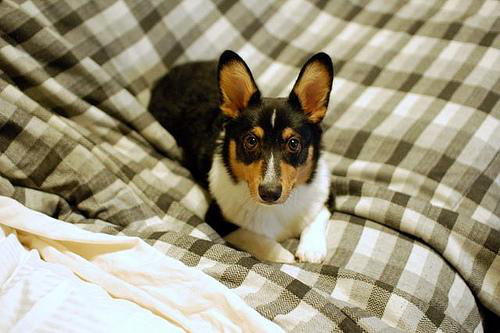

In [17]:
display(Image.open('../input/stanford-dogs-dataset/images/Images/n02113023-Pembroke/n02113023_10636.jpg'))

In [18]:
filename_images[9]

'../input/stanford-dogs-dataset/images/Images/n02091635-otterhound/n02091635_3379.jpg'

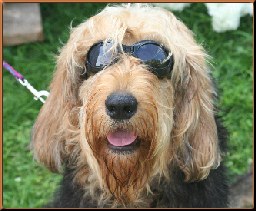

In [19]:
display(Image.open(filename_images[9]))

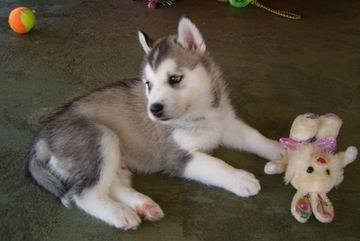

In [20]:
display(Image.open(filename_images[125]))

In [21]:
df_des.groupby('picnum').count()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127
picnum,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200
1,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200
2,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200
3,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200
4,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200,200

In [22]:
df_des.reset_index(drop=True, inplace=True)

In [23]:
clusterer_clusterer.predict(df_des.iloc[0:6, 1:])

array([784, 256, 127, 206, 408, 158], dtype=int32)

In [24]:
cluster_numbers = clusterer_clusterer.predict(df_des.iloc[:, 1:])

In [25]:
len(cluster_numbers)

397434

In [26]:
df_des_clusters = pd.DataFrame(cluster_numbers)

In [27]:
df_des_clusters

,0
0,784
1,256
2,127
3,206
4,408
...,...
397429,995
397430,851
397431,748
397432,200


# Agregate SIFT descriptors to a [N_pics x N_clusters] matrix

In [28]:
df_des_clusters_dummies = pd.get_dummies(df_des_clusters[0])

In [29]:
picnums = df_des.iloc[:, 0]

In [30]:
picnums

0            0
1            0
2            0
3            0
4            0
          ... 
397429    1999
397430    1999
397431    1999
397432    1999
397433    1999
Name: picnum, Length: 397434, dtype: uint16

In [31]:
df_des_clusters_dummies

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,...,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
397429,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
397430,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

In [32]:
df_picnum_clusters = pd.concat([picnums, df_des_clusters_dummies], axis=1)

In [33]:
df_picnum_clusters

,picnum,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,...,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
397429,1999,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
397430,1999,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

In [34]:
df_picnum_agg_clusters = df_picnum_clusters.groupby('picnum').sum()

In [35]:
df_picnum_agg_clusters

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,...,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999
picnum,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,2,2,0,0,0,1,0,0,0,2,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,...,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,2,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0
1,1,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,1,0,1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,...,0,2,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,1,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
2,0,0,1,0,0,0,1,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,1,0,1,...,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0
3,1,0,0,0,1,0,0,1,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,1,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,...,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,2,0,0,1,0,1,0,0,0,0,0,0,0,0,0,2,0,1,0,0,0,1,0,0,0,0,1,0,1,0,1,0,1,0,0,0,0,1,0,0,0,0,1,0,2,1,0,0,0,0,1,0,2,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0
4,1,0,0,0,0,1,0,0,0,1,1,0,0,1,0,1,0,0,0,1,0,2,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,2,0,1,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,1,1,0,0,0,0,0,1,0,0,0,0,0,1,2,0,0,1,0,0,0,0,0,1,2,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,2,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,

In [36]:
df_picnum_agg_clusters = (df_picnum_agg_clusters.T / df_picnum_agg_clusters.T.sum()).T # Normalizing frequencies

In [37]:
df_picnum_agg_clusters.shape

(2000, 1000)

In [38]:
df_picnum_agg_clusters.sum(axis=1)

picnum
0       1.0
1       1.0
2       1.0
3       1.0
4       1.0
       ... 
1995    1.0
1996    1.0
1997    1.0
1998    1.0
1999    1.0
Length: 2000, dtype: float64

# Feature visualisation in 2d

In [39]:
pca = PCA(n_components=6)
scaler = StandardScaler().fit(df_picnum_agg_clusters)
X_scaled = scaler.transform(df_picnum_agg_clusters)
X_reduced = pca.fit_transform(X_scaled)

In [40]:
image_labels = [filename_image.split('/')[5].split('-')[1] for filename_image in filename_images]

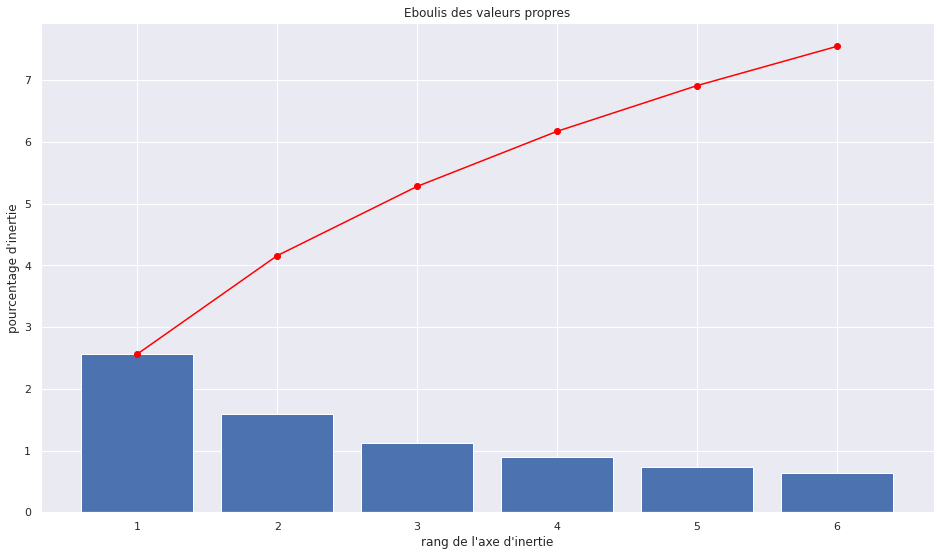

In [41]:
display_scree_plot(pca)

In [42]:
from sklearn.preprocessing import LabelEncoder


df_dogs_races = pd.DataFrame(image_labels)
encoder = LabelEncoder()
numerical_races = encoder.fit_transform(df_dogs_races)

/opt/conda/lib/python3.7/site-packages/sklearn/utils/validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


In [43]:
set(numerical_races)

{0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19}

In [44]:
py.offline.init_notebook_mode(connected=True)


trace_1 = go.Scatter(x = X_reduced[:,0], y = X_reduced[:,1],
                    name = 'Dogs',
                    mode = 'markers',
                    marker=dict(color=numerical_races),
                    text = numerical_races,
                    )


layout = go.Layout(title = 'Image features in 2 dimensions',
                   hovermode = 'closest',
)

fig = go.Figure(data = [trace_1], layout = layout)


py.offline.plot(fig, filename='features_2dplot.html') 

'features_2dplot.html'

## ACP of features

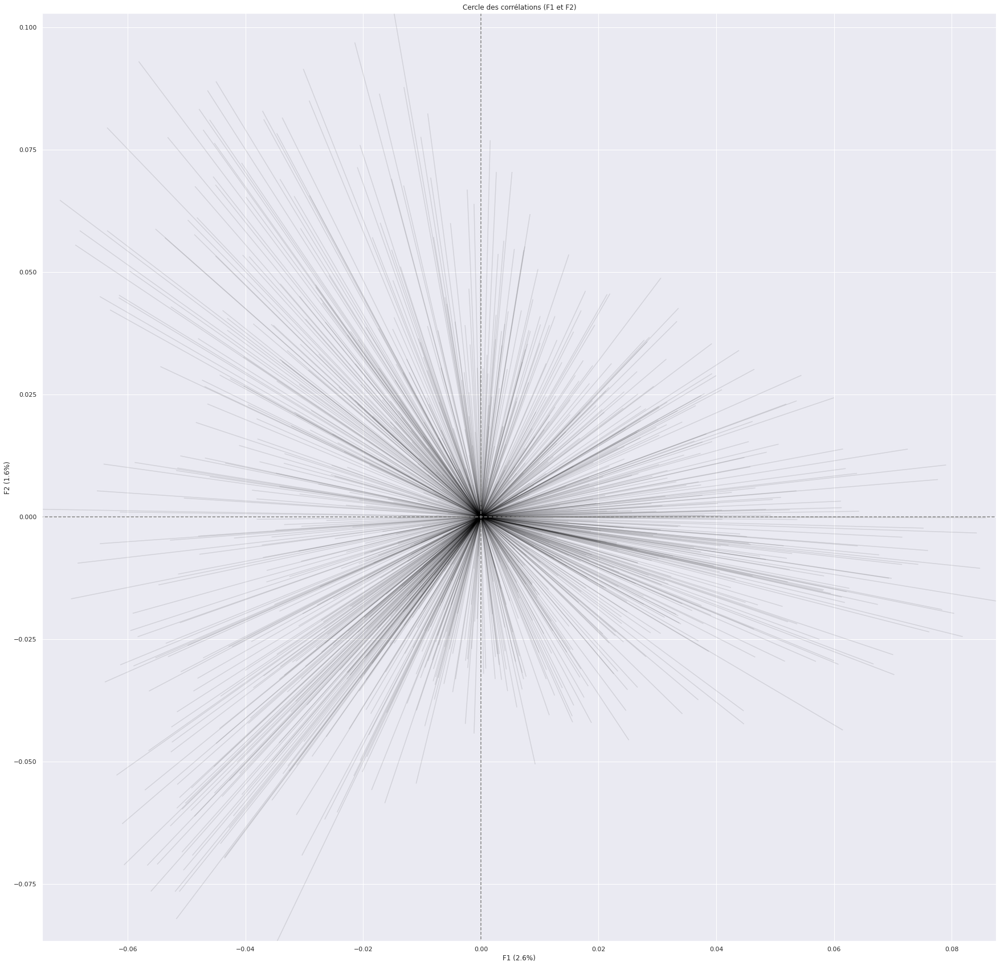

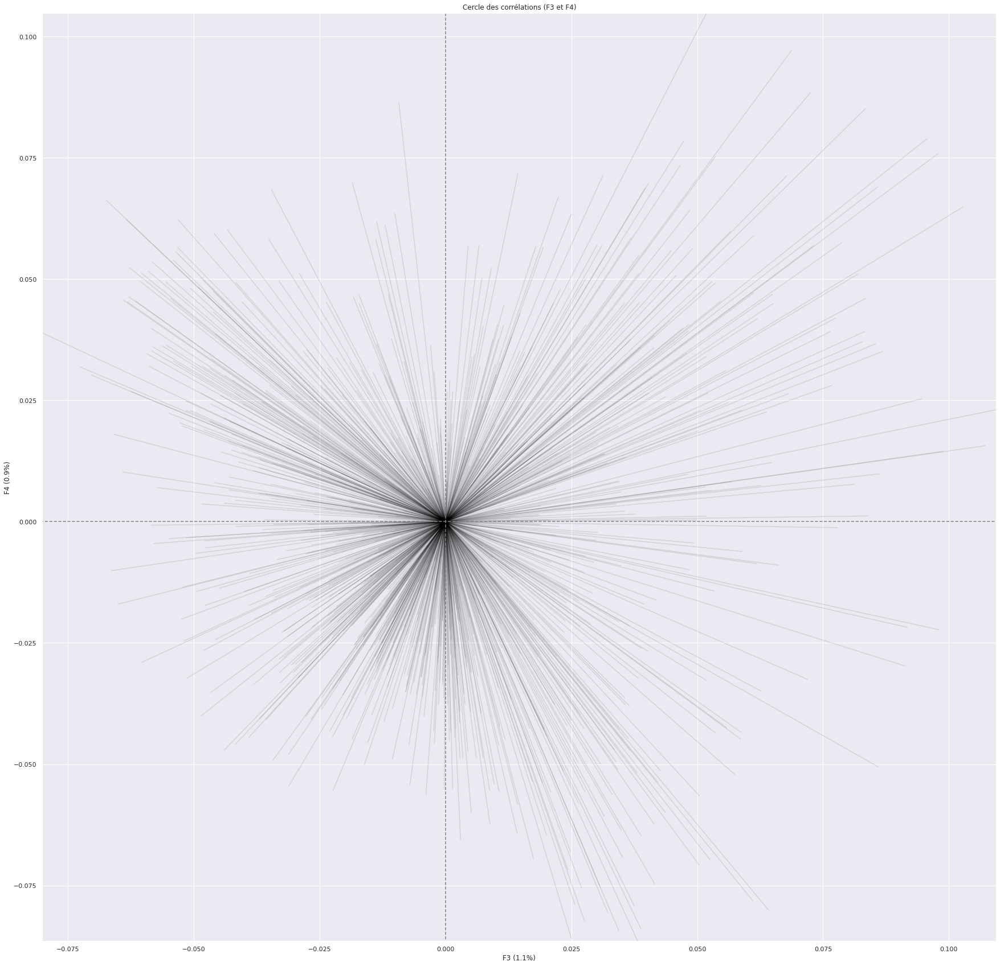

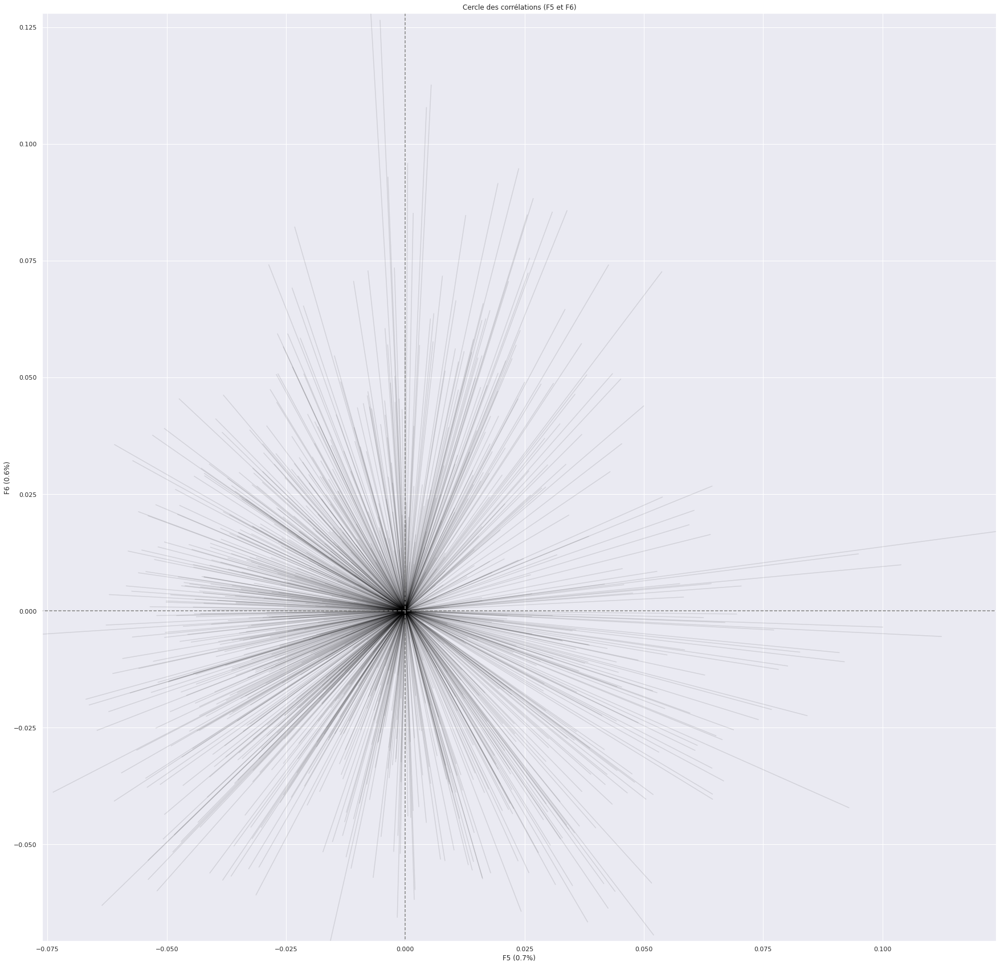

In [45]:
display_circles(pca.components_, 6, pca, [(0,1),(2,3),(4,5)])

# Train a classifier 

In [46]:
image_labels = [filename_image.split('/')[5].split('-')[1] for filename_image in filename_images]

In [47]:
len(image_labels)

2000

In [48]:
df_train, df_test, df_train_labels, df_test_labels = train_test_split(df_picnum_agg_clusters, image_labels, test_size=0.1, random_state=42, shuffle = True, stratify = image_labels)

In [49]:
df_train

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,...,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999
picnum,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
301,0.000,0.000,0.000,0.000,0.010,0.000,0.000,0.000,0.0,0.010,0.0,0.000,0.00,0.0,0.000,0.0,0.0,0.000,0.000,0.000,0.0,0.005,0.0,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.0,0.000,0.005,0.0,0.000,0.0,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.0,0.000,0.00,0.000,0.01,0.005,0.000,0.0,0.000,0.000,0.00,0.000,0.000,0.000,0.005,0.000,0.000,0.000,0.000,0.005,0.000,0.000,0.0,0.000,0.000,0.000,0.000,0.000,0.005,0.000,0.000,0.0,0.00,0.000,0.005,0.000,0.000,0.000,0.000,0.005,0.005,0.000,0.005,0.015,0.000,0.000,0.000,0.0,0.010,0.000,0.000,0.010,0.000,...,0.0,0.0,0.005,0.005,0.000,0.000,0.000,0.005,0.005,0.000,0.0,0.000,0.005,0.000,0.0,0.010,0.000,0.0,0.000,0.0,0.0,0.000,0.00,0.000,0.0,0.000,0.0,0.000,0.000,0.0,0.005,0.005,0.000,0.000,0.005,0.000,0.000,0.005,0.000,0.000,0.000,0.000,0.000,0.000,0.005,0.000,0.005,0.00,0.000,0.000,0.00,0.000,0.000,0.000,0.005,0.005,0.0,0.000,0.000,0.000,0.005,0.00,0.005,0.000,0.0,0.0,0.00,0.000,0.000,0.000,0.000,0.0,0.000,0.005,0.000,0.005,0.0,0.015,0.000,0.000,0.000,0.000,0.01,0.000,0.005,0.0,0.000,0.000,0.000,0.005,0.000,0.000,0.000,0.000,0.000,0.0,0.005,0.000,0.005,0.005
1449,0.000,0.000,0.005,0.000,0.000,0.005,0.000,0.000,0.0,0.015,0.0,0.000,0.00,0.0,0.000,0.0,0.0,0.005,0.000,0.000,0.0,0.000,0.0,0.000,0.000,0.005,0.000,0.000,0.000,0.000,0.0,0.000,0.000,0.0,0.055,0.0,0.000,0.000,0.000,0.000,0.005,0.000,0.000,0.000,0.005,0.000,0.000,0.0,0.000,0.00,0.000,0.00,0.000,0.000,0.0,0.000,0.000,0.00,0.000,0.010,0.005,0.005,0.000,0.000,0.005,0.000,0.005,0.000,0.000,0.0,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.0,0.00,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.0,0.010,0.000,0.000,0.000,0.005,...,0.0,0.0,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.0,0.005,0.000,0.005,0.0,0.000,0.000,0.0,0.005,0.0,0.0,0.000,0.00,0.000,0.0,0.000,0.0,0.000,0.000,0.0,0.000,0.000,0.005,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.005,0.005,0.000,0.000,0.000,0.00,0.000,0.000,0.00,0.015,0.005,0.000,0.000,0.000,0.0,0.005,0.005,0.000,0.000,0.00,0.005,0.005,0.0,0.0,0.00,0.000,0.000,0.000,0.000,0.0,0.000,0.005,0.000,0.005,0.0,0.000,0.000,0.000,0.000,0.000,0.00,0.000,0.000,0.0,0.000,0.000,0.000,0.000,0.000,0.000,0.005,0.000,0.000,0.0,0.005,0.000,0.005,0.005
164,0.000,0.000,0.000,0.005,0.000,0.000,0.000,0.000,0.0,0.000,0.0,0.000,0.01,0.0,0.000,0.0,0.0,0.000,0.000,0.000,0.0,0.000,0.0,0.000,0.005,0.000,0.000,0.005,0.000,0.000,0.0,0.000,0.000,0.0,0.000,0.0,0.000,0.000,0.000,0.000,0.035,0.000,0.000,0.000,0.010,0.000,0.000,0.0,0.000,0.00,0.000,0.00,0.000,0.005,0.0,0.000,0.000,0.01,0.000,0.000,0.000,0.000,0.005,0.005,0.000,0.000,0.000,0.000,0.000,0.0,0.005,0.000,0.000,0.000,0.015,0.000,0.000,0.000,0.0,0.00,0.005,0.000,0.000,0.005,0.000,0.000,0.005,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.0,0.000,0.005,0.000,0.005,0.000,...,0.0,0.0,0.000,0.000,0.000,0.000,0.000,0.000,0.005,0.000,0.0,0.000,0.000,0.015,0.0,0.000,0.010,0.0,0.000,0.0,0.0,0.000,0.01,0.010,0.0,0.000,0.0,0.000,0.000,0.0,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.

In [50]:
#Check distribution of labels on test set : good, they are stratified
pd.DataFrame(df_test_labels).groupby(0)[0].count()

0
Afghan_hound                      10
Airedale                          10
American_Staffordshire_terrier    10
Border_terrier                    10
Chihuahua                         10
Eskimo_dog                        10
Great_Pyrenees                    10
Rhodesian_ridgeback               10
affenpinscher                     10
bloodhound                        10
bluetick                          10
borzoi                            10
briard                            10
bull_mastiff                      10
flat                              10
miniature_pinscher                10
otterhound                        10
redbone                           10
silky_terrier                     10
standard_poodle                   10
Name: 0, dtype: int64

## Decision Tree and Random forest

In [51]:
model = DecisionTreeClassifier()

model.fit(df_train, df_train_labels)
df_predictions_train = model.predict(df_train)
df_predictions_test = model.predict(df_test)

In [52]:
df_predictions_train

array(['bull_mastiff', 'miniature_pinscher', 'Eskimo_dog', ...,
       'Chihuahua', 'Airedale', 'flat'], dtype='<U30')

In [53]:
df_train_labels

['bull_mastiff',
 'miniature_pinscher',
 'Eskimo_dog',
 'redbone',
 'bluetick',
 'standard_poodle',
 'flat',
 'Rhodesian_ridgeback',
 'Border_terrier',
 'Afghan_hound',
 'otterhound',
 'standard_poodle',
 'bloodhound',
 'Eskimo_dog',
 'Airedale',
 'otterhound',
 'redbone',
 'flat',
 'Afghan_hound',
 'bull_mastiff',
 'silky_terrier',
 'Afghan_hound',
 'bloodhound',
 'American_Staffordshire_terrier',
 'standard_poodle',
 'Afghan_hound',
 'Chihuahua',
 'Airedale',
 'Border_terrier',
 'bluetick',
 'redbone',
 'bloodhound',
 'Eskimo_dog',
 'silky_terrier',
 'Border_terrier',
 'Chihuahua',
 'miniature_pinscher',
 'Rhodesian_ridgeback',
 'Rhodesian_ridgeback',
 'Rhodesian_ridgeback',
 'bloodhound',
 'Eskimo_dog',
 'flat',
 'bluetick',
 'briard',
 'American_Staffordshire_terrier',
 'American_Staffordshire_terrier',
 'borzoi',
 'redbone',
 'otterhound',
 'Great_Pyrenees',
 'redbone',
 'Border_terrier',
 'bloodhound',
 'bluetick',
 'American_Staffordshire_terrier',
 'flat',
 'Eskimo_dog',
 'mini

In [54]:
precision_score(df_train_labels, df_predictions_train, average='micro')

0.9994444444444445

In [55]:
recall_score(df_train_labels, df_predictions_train, average='micro')

0.9994444444444445

In [56]:
precision_score(df_test_labels, df_predictions_test, average='micro')

0.035

In [57]:
recall_score(df_test_labels, df_predictions_test, average='micro')

0.035

In [58]:
 #__init__(n_estimators=100, *, criterion='gini', max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_features='auto', max_leaf_nodes=None, min_impurity_decrease=0.0, min_impurity_split=None, bootstrap=True, oob_score=False, n_jobs=None, random_state=None, verbose=0, warm_start=False, class_weight=None, ccp_alpha=0.0, max_samples=None)[source]

In [59]:
# Standard scale does not make a big difference with random forest
#scaler = StandardScaler()
#df_train = scaler.fit_transform(df_train)
#df_test = scaler.transform(df_test)

In [60]:
model = RandomForestClassifier(max_depth=100, max_features=20, max_leaf_nodes=50,
                       n_estimators=5000, random_state=42)

model.fit(df_train, df_train_labels)
df_predictions_train = model.predict(df_train)
df_predictions_test = model.predict(df_test)

In [61]:
precision_score(df_train_labels, df_predictions_train, average='micro')

0.9961111111111111

In [62]:
recall_score(df_train_labels, df_predictions_train, average='micro')

0.9961111111111111

In [63]:
precision_score(df_test_labels, df_predictions_test, average='micro')

0.125

In [64]:
# Before gridsearch : was 0.45

In [65]:
recall_score(df_test_labels, df_predictions_test, average='micro')

0.125

## Error analysis

In [66]:
confusion_mx = confusion_matrix(df_test_labels, df_predictions_test, labels=list(set(df_test_labels)))

In [67]:
row_sums = confusion_mx.sum(axis=1, keepdims=True)
norm_confusion_mx = confusion_mx / row_sums

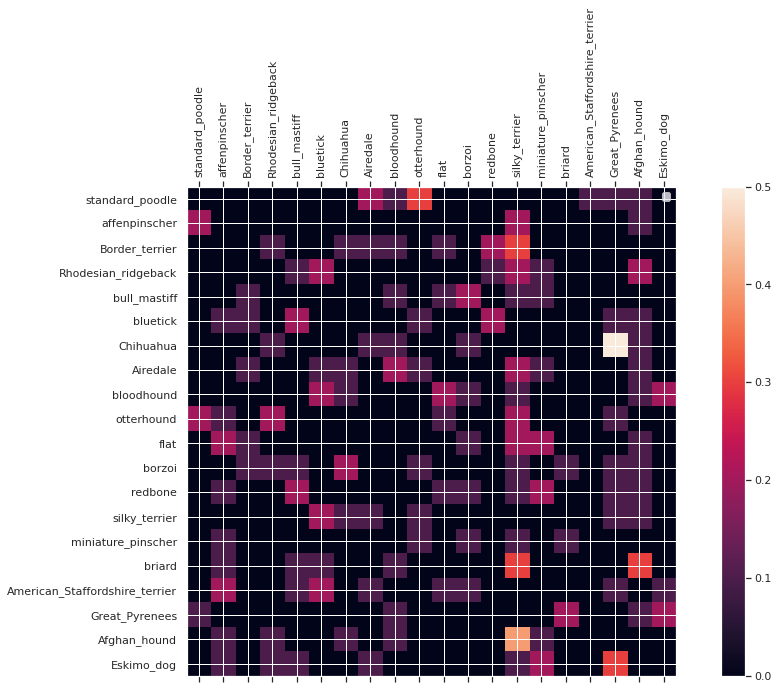

In [68]:
np.fill_diagonal(norm_confusion_mx, 0)

figure = plt.figure() 
axes = figure.add_subplot(111) 
caxes = axes.matshow(norm_confusion_mx)
figure.colorbar(caxes)

plt.xticks(rotation=90) 
plt.yticks(rotation=0) 

plt.xticks(np.arange(20), list(set(df_test_labels)))
plt.yticks(np.arange(20), list(set(df_test_labels)))
plt.legend()

In [69]:
len(df_predictions_test)

200

In [70]:
len(df_test_labels)

200

In [71]:
df_predictions_compare = pd.DataFrame({'actual': df_test_labels, 'pred': df_predictions_test})

In [72]:
df_predictions_compare['count'] = 1

In [73]:
df_predictions_compare

,actual,pred,count
0,borzoi,Afghan_hound,1
1,bull_mastiff,bull_mastiff,1
2,Rhodesian_ridgeback,silky_terrier,1
3,bluetick,bluetick,1
4,Eskimo_dog,Great_Pyrenees,1
5,flat,Afghan_hound,1
6,Airedale,bloodhound,1
7,flat,flat,1
8,flat,borzoi,1
9,standard_poodle,otterhound,1


Text(0.5, 1.0, 'Top misclassed pairs')

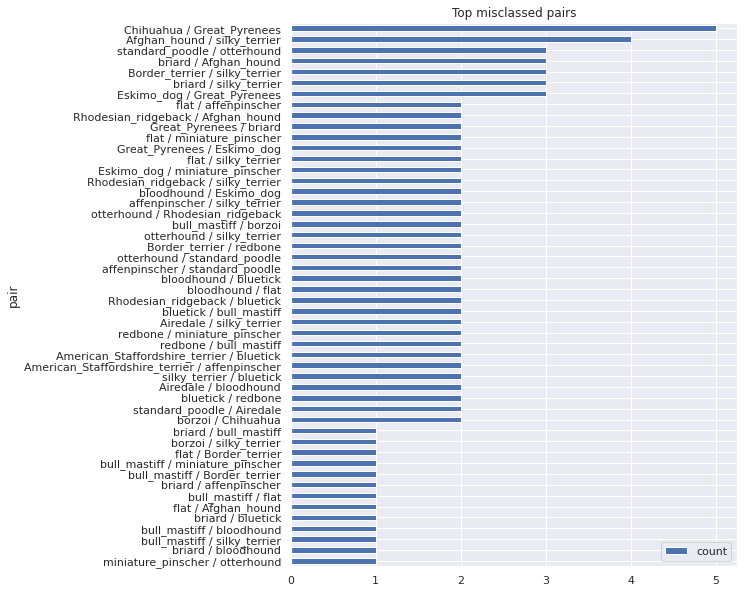

In [74]:
misclass_df = df_predictions_compare[df_predictions_compare['actual'] != df_predictions_compare['pred']].groupby(['actual', 'pred']).sum().sort_values(['count'], ascending=False).reset_index()
misclass_df['pair'] = misclass_df['actual'] + ' / ' + misclass_df['pred']
misclass_df = misclass_df[['pair', 'count']].take(range(50))
misclass_df.sort_values(['count']).plot.barh(figsize=(8, 10), x='pair')
plt.title('Top misclassed pairs')

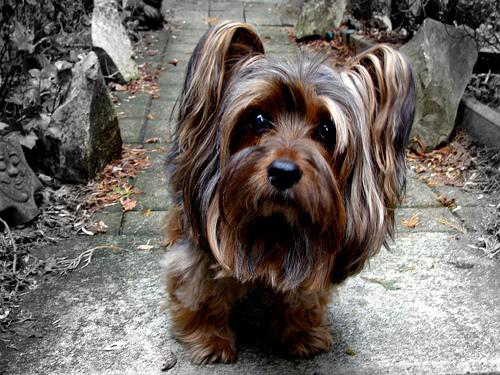

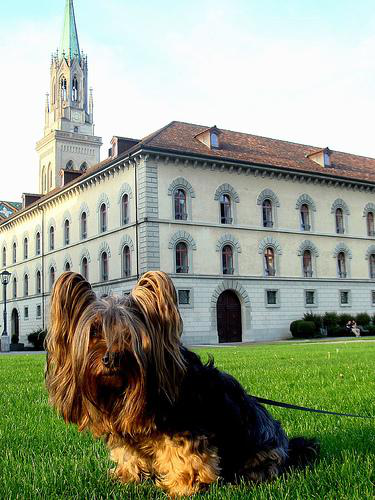

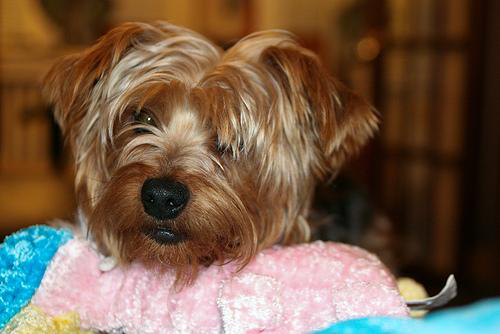

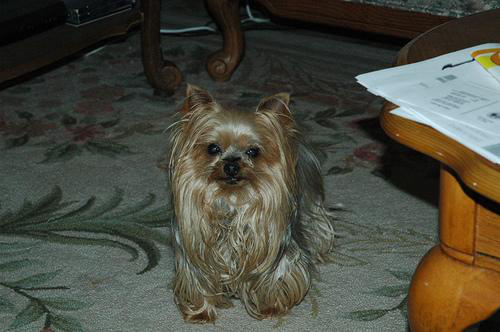

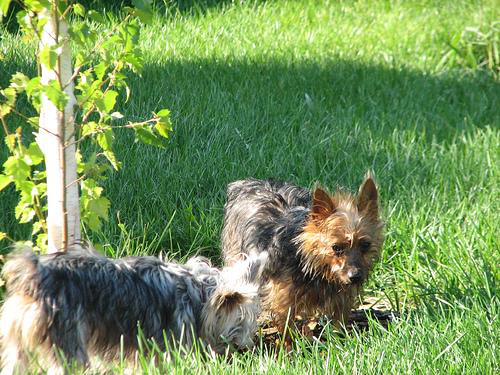

...

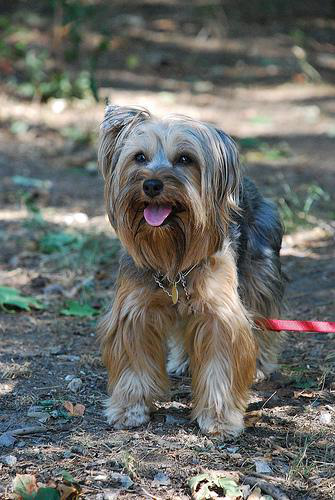

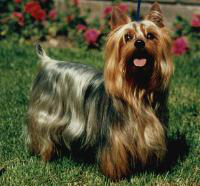

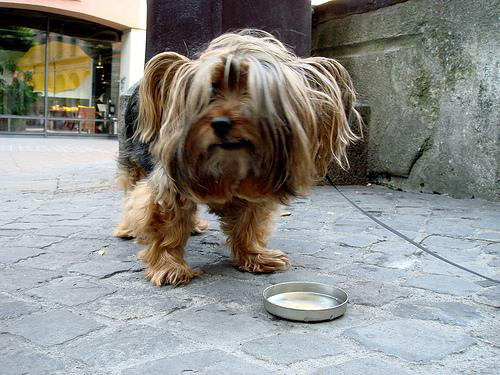

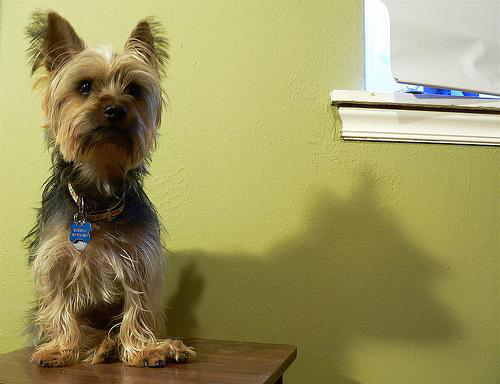

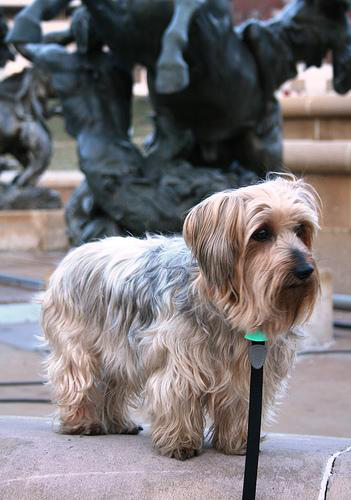

In [75]:
# Print dogs from certain class

train_indexes = [i for i,x in enumerate(df_train_labels) if x == 'silky_terrier'] 
indexes = df_train.iloc[train_indexes, :].index  # Get original indexes before the train/test split (the ones that match with filenames list)


MAX_DISPLAY_IMAGES = 102
cnt_display_images = 0

for index in indexes:
    if (cnt_display_images < MAX_DISPLAY_IMAGES):
        display(Image.open(filename_images[index]))
    
        cnt_display_images += 1

In [76]:
print(f'We count 28 images on {cnt_display_images} total for Great Pyrenees where humans are present ,  and 20 for Chihuahua !        13 for bull_mastiff, 10 for miniature_pinscher ')

We count 28 images on 90 total for Great Pyrenees where humans are present ,  and 20 for Chihuahua !        13 for bull_mastiff, 10 for miniature_pinscher 


# Try Grid Search

In [77]:
'''
param_grid = {
        'max_depth': [5, 10, 100, 1000],
        'max_features': [5, 10, 20, 50, 100], 
        'max_leaf_nodes': [5, 10, 20, 50, 100],
        'n_estimators': [10, 100, 1000]
        }
'''

'''
param_grid = {
        'max_depth': [100, 500],
        'max_features': [20], 
        'max_leaf_nodes': [50],
        'n_estimators': [1000, 2000, 5000]
        }
'''

param_grid = {
        'max_depth': [100],
        'max_features': [20], 
        'max_leaf_nodes': [50],
        'n_estimators': [5000, 10000, 20000]
        }

In [78]:
# Commented out because I've already run it and checked the results (see cells below)
'''
scorer = make_scorer(precision_score_micro, greater_is_better=True)

grid_search = GridSearchCV(model, param_grid, verbose=10, error_score=np.nan, scoring=scorer, cv=5, iid=False)
grid_search.fit(df_train, df_train_labels)
'''

'\nscorer = make_scorer(precision_score_micro, greater_is_better=True)\n\ngrid_search = GridSearchCV(model, param_grid, verbose=10, error_score=np.nan, scoring=scorer, cv=5, iid=False)\ngrid_search.fit(df_train, df_train_labels)\n'

In [79]:
#grid_search.best_estimator_

In [80]:
#grid_search.best_estimator_
'''
Best estimator was, with all dog classes :
RandomForestClassifier(max_depth=5, max_features=10, max_leaf_nodes=20,
                       random_state=42)
                       
And with 2 dog classes :
RandomForestClassifier(max_depth=10, max_features=20, max_leaf_nodes=50,
                       random_state=42)
                       
And with 20 dog classes + better cluster number (1000) :
RandomForestClassifier(max_depth=100, max_features=20, max_leaf_nodes=50,
                       n_estimators=1000, random_state=42)

=> We try more estimators, and we get best :
RandomForestClassifier(max_depth=100, max_features=20, max_leaf_nodes=50,
                       n_estimators=5000, random_state=42)
'''

'\nBest estimator was, with all dog classes :\nRandomForestClassifier(max_depth=5, max_features=10, max_leaf_nodes=20,\n                       random_state=42)\n                       \nAnd with 2 dog classes :\nRandomForestClassifier(max_depth=10, max_features=20, max_leaf_nodes=50,\n                       random_state=42)\n                       \nAnd with 20 dog classes + better cluster number (1000) :\nRandomForestClassifier(max_depth=100, max_features=20, max_leaf_nodes=50,\n                       n_estimators=1000, random_state=42)\n\n=> We try more estimators, and we get best :\nRandomForestClassifier(max_depth=100, max_features=20, max_leaf_nodes=50,\n                       n_estimators=5000, random_state=42)\n'

In [81]:
'''
df_grid_search_results = pd.concat([pd.DataFrame(grid_search.cv_results_["params"]),pd.DataFrame(grid_search.cv_results_["mean_test_score"], columns=["mean_test_score"])],axis=1)
df_grid_search_results = pd.concat([df_grid_search_results,pd.DataFrame(grid_search.cv_results_["std_test_score"], columns=["std_test_score"])],axis=1)
'''

'\ndf_grid_search_results = pd.concat([pd.DataFrame(grid_search.cv_results_["params"]),pd.DataFrame(grid_search.cv_results_["mean_test_score"], columns=["mean_test_score"])],axis=1)\ndf_grid_search_results = pd.concat([df_grid_search_results,pd.DataFrame(grid_search.cv_results_["std_test_score"], columns=["std_test_score"])],axis=1)\n'

In [82]:
'''
df_predictions_train = grid_search.predict(df_train)
df_predictions_test = grid_search.predict(df_test)
'''

'\ndf_predictions_train = grid_search.predict(df_train)\ndf_predictions_test = grid_search.predict(df_test)\n'

## KNN

In [83]:
model = KNeighborsClassifier(n_neighbors=10)

model.fit(df_train, df_train_labels)
df_predictions_train = model.predict(df_train)
df_predictions_test = model.predict(df_test)

In [84]:
precision_score(df_train_labels, df_predictions_train, average='micro')

0.2927777777777778

In [85]:
recall_score(df_train_labels, df_predictions_train, average='micro')

0.2927777777777778

In [86]:
precision_score(df_test_labels, df_predictions_test, average='micro')

0.06

In [87]:
recall_score(df_test_labels, df_predictions_test, average='micro')

0.06

## Generate random matrix, and DecisionTree

In [88]:
df_picnum_agg_clusters.mean()

0      0.001019
1      0.000921
2      0.000879
3      0.000843
4      0.000929
         ...   
995    0.001404
996    0.000796
997    0.001102
998    0.000942
999    0.000878
Length: 1000, dtype: float64

In [89]:
df_picnum_agg_clusters.mean().mean()

0.0009999999999999929

In [90]:
df_picnum_agg_clusters.std().mean()

0.0026190940706593367

In [91]:
df_picnum_agg_clusters.max().max()

0.635

In [92]:
df_picnum_agg_clusters.max().min()

0.01

In [93]:
#randomNums = np.random.normal(loc=2, scale=2.18, size=(12000, NB_CLUSTERS))
randomNums = np.random.normal(loc=2, scale=2.18, size=(NB_DOGS_PER_RACE * NB_CLASSES, NB_CLUSTERS))
randomInts = np.round(randomNums)

In [94]:
randomInts.min()

-9.0

In [95]:
#df_random = pd.DataFrame(np.random.randint(0,100,size=(12000, NB_CLUSTERS)))
df_random = pd.DataFrame(randomInts)

In [96]:
df_train, df_test, df_train_labels, df_test_labels = train_test_split(df_random, image_labels, test_size=0.1, random_state=42, shuffle = True, stratify = image_labels)

In [97]:
#model = RandomForestClassifier(random_state=42, max_depth=15, max_features=20, max_leaf_nodes=100, n_estimators=1000)
model = RandomForestClassifier(random_state=42, max_depth=5, max_features=10, max_leaf_nodes=20)

model.fit(df_train, df_train_labels)
df_predictions_train = model.predict(df_train)
df_predictions_test = model.predict(df_test)

In [98]:
precision_score(df_train_labels, df_predictions_train, average='micro')

0.7088888888888889

In [99]:
recall_score(df_train_labels, df_predictions_train, average='micro')

0.7088888888888889

In [100]:
precision_score(df_test_labels, df_predictions_test, average='micro')

0.05

In [101]:
recall_score(df_test_labels, df_predictions_test, average='micro')

0.05

In [102]:
import cv2
sift = cv2.xfeatures2d.SIFT_create()

def visualize_keypoints(PATH_CLASS, nb_pics):
    for root, dirs, files in os.walk(PATH_CLASS):
        path = root.split(os.sep)

        #cnt_classes += 1
                

        i = 0    
        for file in files:
            if (i > nb_pics - 1):
                break
                
            img = cv2.imread(os.path.join(root, file))

            kp, des = sift.detectAndCompute(img, None)

            kp_sorted_indices = [i[0] for i in sorted(enumerate(kp), key=lambda x:x[1].response, reverse=True)] # Sort by pixel importance descending
            des = des[kp_sorted_indices[0:NB_KEYPOINTS_PER_DOG], :]
            #kp = kp[kp_sorted_indices[0:NB_KEYPOINTS_PER_DOG], :]

            imgcv_keypoints = cv2.drawKeypoints(img, kp, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS, outImage=None)
            
            
            write_path = os.path.join("/kaggle", "working/") + file + '_kp.jpg'
            print(write_path)
            cv2.imwrite(write_path,imgcv_keypoints)

            
            i += 1
            #pic_number += 1    
    
    

In [103]:
PATH_CLASS_1 = '../input/stanford-dogs-dataset/images/Images/n02085620-Chihuahua'
PATH_CLASS_2 = '../input/stanford-dogs-dataset/images/Images/n02111500-Great_Pyrenees'

In [104]:
visualize_keypoints(PATH_CLASS_1, 10)
visualize_keypoints(PATH_CLASS_2, 10)

/kaggle/working/n02085620_275.jpg_kp.jpg
/kaggle/working/n02085620_2793.jpg_kp.jpg
/kaggle/working/n02085620_2693.jpg_kp.jpg
/kaggle/working/n02085620_2188.jpg_kp.jpg
/kaggle/working/n02085620_8637.jpg_kp.jpg
/kaggle/working/n02085620_2706.jpg_kp.jpg
/kaggle/working/n02085620_3826.jpg_kp.jpg
/kaggle/working/n02085620_3110.jpg_kp.jpg
/kaggle/working/n02085620_4998.jpg_kp.jpg
/kaggle/working/n02085620_3975.jpg_kp.jpg
/kaggle/working/n02111500_4636.jpg_kp.jpg
/kaggle/working/n02111500_1590.jpg_kp.jpg
/kaggle/working/n02111500_3011.jpg_kp.jpg
/kaggle/working/n02111500_3710.jpg_kp.jpg
/kaggle/working/n02111500_2151.jpg_kp.jpg
/kaggle/working/n02111500_1743.jpg_kp.jpg
/kaggle/working/n02111500_6792.jpg_kp.jpg
/kaggle/working/n02111500_4687.jpg_kp.jpg
/kaggle/working/n02111500_26.jpg_kp.jpg
/kaggle/working/n02111500_8721.jpg_kp.jpg
